In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import os, tarfile, sys
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
import scipy
from keras.models import load_model

In [ ]:
# creo URL per file locale 

myFile = 'final_dataset.zip'
fullPath = os.path.abspath("/content/drive/MyDrive/" + myFile) # or similar, depending on scenario
path_to_downloaded_file = tf.keras.utils.get_file(myFile, 'file://'+fullPath, extract=True)

Exception: ignored

In [ ]:
batch_size = 128
img_height = 224
img_width = 224

#data_dir = '/content/drive/MyDrive/dataset_27k'
data_dir = '/root/.keras/datasets/final_dataset'

In [ ]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  labels='inferred',
  label_mode='int', #sparse categorical cross entropy, se categorical -> categorical c..e
  subset="training",
  color_mode='rgb',
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

val_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  labels='inferred',
  label_mode='int',
  subset="validation",
  color_mode='rgb',
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 70900 files belonging to 76 classes.
Using 56720 files for training.
Found 70900 files belonging to 76 classes.
Using 14180 files for validation.


In [ ]:
class_names = train_ds.class_names
print(class_names)

['Ghepardi', 'Leoni', 'Lupi', 'Tigri', 'alces-alces', 'alga', 'anatra', 'apis-mellifera', 'avvoltoio', 'balena', 'bison-bison', 'bradypus-variegatus', 'cane', 'canguro', 'capra', 'cavallo', 'cervo', 'coniglio', 'crocodylus-niloticus', 'delfino', 'elefante', 'farfalla', 'fenicottero', 'formica', 'gallina', 'gatto', 'giraffa-camelopardalis', 'hippopotamus-amphibius', 'iguana-iguana', 'impala', 'koala', 'lontra', 'lucertola', 'martes-americana', 'medusa', 'mucca', 'n01443537(goldfish)', 'n01518878(ostrich)', 'n01632777(axolotl)', 'n01644900(tailed_frog)', 'n01669191(box_turtle)', 'n01806143(peacock)', 'n01944390(snail)', 'n02077923(sea_lion)', 'n02096294(Australian_terrier)', 'narvalo', 'okapia-johnstoni', 'orcinus-orca', 'ornithorhynchus-anatinus', 'orso', 'panda', 'panthera-onca', 'pappagallo', 'pecora', 'pesce', 'pinguino', 'pipistrello', 'polipo', 'procyon-lotor', 'puma', 'puma-concolor', 'ragno', 'rattus-rattus', 'rinoceronte', 'scarafaggio', 'scimmia', 'scoiattolo', 'scorpione', 'se

In [ ]:
train_ds.file_paths

In [ ]:
#selection of pre-trained model

pt_model = tf.keras.applications.EfficientNetV2B0(
    include_top=False,
    weights="imagenet",
    input_shape=(224,224,3),
    pooling='avg',
    classifier_activation=None,
    include_preprocessing=True,
)
#pt_model.summary()

for layer in pt_model.layers[0:-17]:
    layer.trainable = False

pt_model.summary()

model = tf.keras.models.Sequential()
model.add(pt_model)
model.add(layers.Dense(150, activation='relu'))
model.add(layers.Dense(len(class_names)))


24289280/24274472 [==============================] - 0s 0us/step
Model: "efficientnetv2-b0"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 224, 224, 3)  0           ['input_1[0][0]']                
                                                                                                  
 normalization (Normalization)  (None, 224, 224, 3)  0           ['rescaling[0][0]']              
                                                                                                  
 stem_conv (Conv2

NameError: ignored

In [ ]:
# loss and optimizer
# con un dataset non etichettato non si può usare categorical cross entropy
loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True)
optim = keras.optimizers.Adam(learning_rate=0.003) 
metrics = ["accuracy"]

model.compile(optimizer=optim, loss=loss, metrics=metrics)

In [ ]:
early_stopping = EarlyStopping(monitor='val_loss', mode='min',verbose=1,patience=6,min_delta=0.0001)
checkpoint = ModelCheckpoint('/content/drive/MyDrive/model/effnet70k_76class_pool.h5', monitor='val_loss', mode='min', save_best_only=True)
model.fit(train_ds, epochs=50, validation_data=val_ds, callbacks=[early_stopping,checkpoint])

Epoch 1/50
444/444 [==============================] - 150s 293ms/step - loss: 0.3728 - accuracy: 0.9035 - val_loss: 0.1905 - val_accuracy: 0.9460
Epoch 2/50
444/444 [==============================] - 121s 268ms/step - loss: 0.0978 - accuracy: 0.9714 - val_loss: 0.1588 - val_accuracy: 0.9549
Epoch 3/50
444/444 [==============================] - 119s 266ms/step - loss: 0.0506 - accuracy: 0.9847 - val_loss: 0.1648 - val_accuracy: 0.9556
Epoch 4/50
443/444 [============================>.] - ETA: 0s - loss: 0.0371 - accuracy: 0.9886

In [ ]:
model = load_model('/content/drive/MyDrive/model/effnet70kclass_pool.h5')

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetv2-b0 (Function  (None, 1280)             5919312   
 al)                                                             
                                                                 
 dense (Dense)               (None, 100)               128100    
                                                                 
 dense_1 (Dense)             (None, 47)                4747      
                                                                 
Total params: 6,052,159
Trainable params: 729,503
Non-trainable params: 5,322,656
_________________________________________________________________


In [ ]:
### metric part

In [ ]:
mod_feature_extr = load_model('/content/drive/MyDrive/model/effnet70kclass_pool.h5')

In [ ]:
mod_feature_extr.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetv2-b0 (Function  (None, 1280)             5919312   
 al)                                                             
                                                                 
 dense (Dense)               (None, 100)               128100    
                                                                 
 dense_1 (Dense)             (None, 47)                4747      
                                                                 
Total params: 6,052,159
Trainable params: 729,503
Non-trainable params: 5,322,656
_________________________________________________________________


In [ ]:
feat_extr = tf.keras.models.Sequential()
for layer in mod_feature_extr.layers[0:-2]:
  feat_extr.add(layer)

In [ ]:
feat_extr.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetv2-b0 (Function  (None, 1280)             5919312   
 al)                                                             
                                                                 
Total params: 5,919,312
Trainable params: 596,656
Non-trainable params: 5,322,656
_________________________________________________________________


In [ ]:
#gallery_dir = '/content/drive/MyDrive/dataset/validation/gallery/'
#query_dir = '/content/drive/MyDrive/dataset/validation/query/'

In [ ]:
test_dt = 'challenge_test_data.zip'
fullPath = os.path.abspath("/content/drive/MyDrive/" + test_dt) # or similar, depending on scenario
path_to_downloaded_file = tf.keras.utils.get_file(test_dt, 'file://'+fullPath, extract=True)

376283136/376271190 [==============================] - 4s 0us/step


In [ ]:
path_to_downloaded_file

'/root/.keras/datasets/challenge_test_data.zip'

In [ ]:
gallery_dir = '/root/.keras/datasets/gallery/'
query_dir = '/root/.keras/datasets/query/'

In [ ]:
print(len(gallery_dir))
print(len(query_dir))

30
28


In [ ]:
from PIL import Image
for fl in os.listdir(query_dir):
  img1 = Image.open(query_dir+fl)
  n = fl[:-3]
  img1.save(query_dir + n +'jpeg')
  os.remove(query_dir+fl)


In [ ]:
for f in os.listdir(gallery_dir):
  img1 = Image.open(gallery_dir+f)
  n = f[:-3]
  img1.save(gallery_dir + n +'jpeg')
  os.remove(gallery_dir+f)


In [ ]:
os.chdir('/root/.keras/datasets/gallery/')
!ls


In [ ]:
os.chdir('/root/.keras/datasets/gallery/')
!ls

In [ ]:
gallery_ds = tf.keras.utils.image_dataset_from_directory(
  gallery_dir,
  labels=None,
  color_mode='rgb',
  shuffle=False,
  image_size=(img_height, img_width),
  batch_size=batch_size)

query_ds = tf.keras.utils.image_dataset_from_directory(
  query_dir,
  labels=None,
  shuffle=False,
  color_mode='rgb',
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 6355 files belonging to 1 classes.
Found 65 files belonging to 1 classes.


In [ ]:
gallery_ds.file_paths

In [ ]:
query_ds.file_paths

In [ ]:
gallery_features = feat_extr.predict(gallery_ds)
query_features = feat_extr.predict(query_ds)

In [ ]:
pairwise_dist = scipy.spatial.distance.cdist(query_features, gallery_features, 'minkowski', p=2.)

In [ ]:
pairwise_dist.shape

(65, 6355)

In [ ]:
indices = np.argsort(pairwise_dist, axis=-1)

In [ ]:
indices.shape

(65, 6355)

In [ ]:
indices[0][:8]

array([306,  54, 404,  11, 484,  96, 349,  53])

In [ ]:
gallery_ds.file_paths[53]

'/root/.keras/datasets/gallery/026142f9f02c2116c07e033d4dadf591b414c61e.jpeg'

In [ ]:
res_dict=dict()
res_dict["groupname"] = "request"
res_dict["images"] = dict()

In [ ]:
def load_image3(file_path):
  img = tf.keras.utils.load_img(file_path, color_mode='rgb', target_size=(224,224), interpolation='nearest')
  img = tf.keras.utils.img_to_array(img)
  img /=255
  return img

def k_nn(query_num, k):
  global res_dict
  li = []
  #print(query_label[query_num])
  immagine = load_image3(query_ds.file_paths[query_num])
  plt.imshow(immagine)
  chiave = query_ds.file_paths[query_num]
  chiave = chiave[28:-4]+'jpg'

  fig = plt.figure(figsize=(25,10))
  for i, match in enumerate(indices[query_num][:k]):
    #print(gallery_label[match])
    nn = load_image3(gallery_ds.file_paths[match])
    ob = gallery_ds.file_paths[match]
    ob = ob[30:-4]+'jpg'
    li.append(ob)
    fig.add_subplot(1,len(indices[query_num][:k]),i+1)
    plt.imshow(nn)
  
  res_dict["images"][chiave] = li

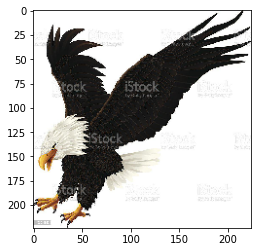

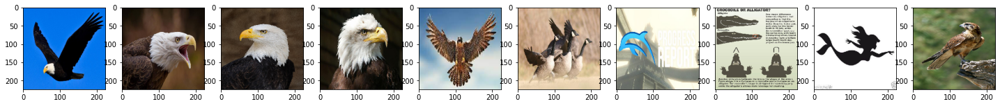

In [ ]:
k_nn(0,10)

In [ ]:
res_dict

{'groupname': 'request',
 'images': {'013c80f43deff8d61b6a2021f9b0a335665fdd1f.jpg': ['0e6498edcff0e72806cbc68cee1ae886e40f526c.jpg',
   'a53c8107acc5c49fb0d70416312b69cbb3fa8b43.jpg',
   '367305c879da423477c25714abaa99812ceee04b.jpg',
   '30df80060dd706ff273bb4e305380d7e77938a46.jpg',
   '7eda05e2c4f85d839ff26fe2a24be1971eb9c922.jpg',
   'ba87b98e1025267fdda5205c5e26ef275ec0a650.jpg',
   'de05675cbba26ba06380985725c18d9ff70d43ce.jpg',
   '6e1fb7c5062e25a78cf5f2e9c16114fbc6109373.jpg',
   'ae4b3a26a75b77e89c931f9ee561231aa683b84d.jpg',
   'a7553a91bb0114b38e7150548562e14618e76a93.jpg'],
  '03ee85dcb5158552d2895d6d37effd2fad0fffde.jpg': ['d7bd17b389a90048fee2459020ef020e88d80c13.jpg',
   '2abb7ad33c99d7c2d71bc227e5c2aa41beef420c.jpg',
   'd96a91a6cbc68171d29c42d8be67e2b7fa739b13.jpg',
   '18f7465534f1ac12cb2c55c0906a59f98242d6b3.jpg',
   '2bbd22fb17bc47e064b4c1be88cadf16a09483e7.jpg',
   'a83503289d2e7dc5358bb121b22ab05a9c922724.jpg',
   'e6fcdfde48f79feeb12a4643d7096982d00c0927.jpg',
 

In [ ]:
import json

In [ ]:
with open("/content/drive/MyDrive/result_effnetv2b0.json","w") as f:
        json.dump(res_dict, f)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


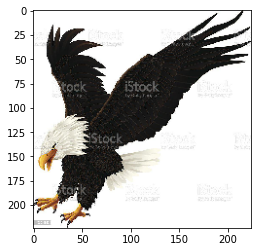

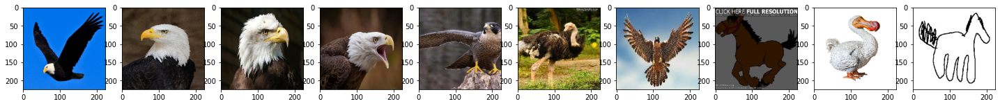

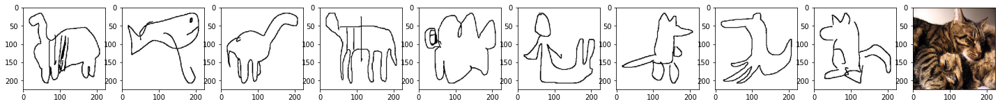

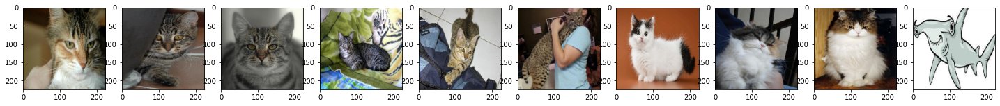

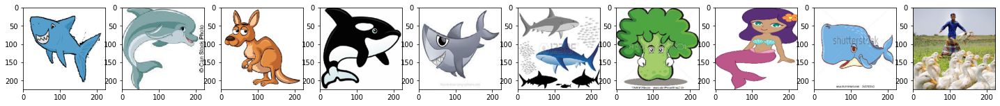

...

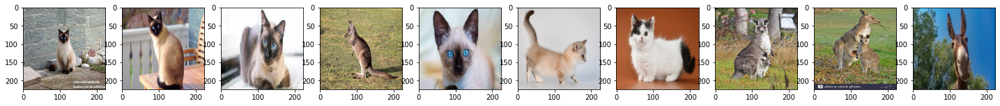

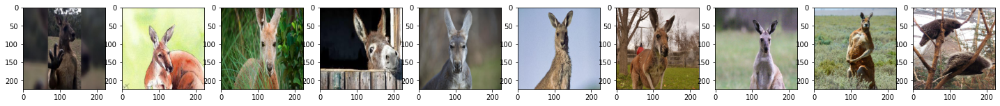

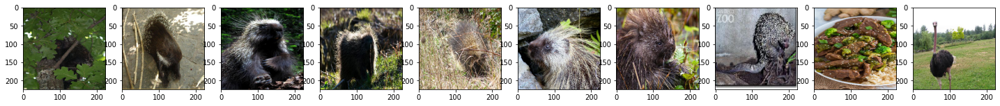

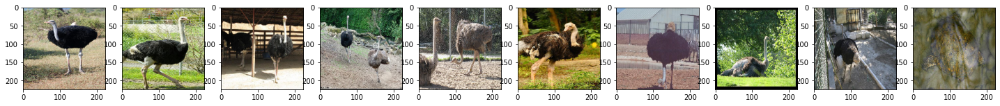

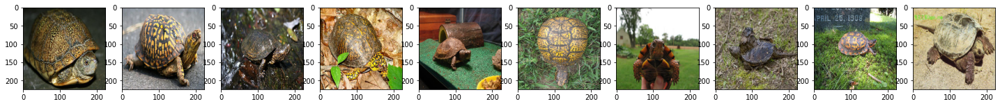

In [ ]:
for q in range(len(query_ds.file_paths)):
  k_nn(q,10)


In [ ]:
goldfish = 'goldfish'
axolotl = 'axolotl'
ostrich = 'ostrich'
terrier = 'terrier' 
frog = 'frog'
turtle = 'turtle'
peacock = 'peacock'
snail = 'snail'
sea_lion = 'sea_lion'
mouse = 'mouse'


    

def evaluation(query_num, k):
  count = 0

  if goldfish in query_ds.file_paths[query_num]:
    class_name = 'goldfish'
  if axolotl in query_ds.file_paths[query_num]:
    class_name = 'axolotl'
  if ostrich in query_ds.file_paths[query_num]:
    class_name = 'ostrich'
  if terrier in query_ds.file_paths[query_num]:
    class_name = 'terrier'
  if frog in query_ds.file_paths[query_num]:
    class_name = 'frog'
  if turtle in query_ds.file_paths[query_num]:
    class_name = 'turtle'
  if peacock in query_ds.file_paths[query_num]:
    class_name = 'peacock'
  if snail in query_ds.file_paths[query_num]:
    class_name = 'snail'
  if sea_lion in query_ds.file_paths[query_num]:
    class_name = 'sea_lion'
  if mouse in query_ds.file_paths[query_num]:
    class_name = 'mouse'

  for match in indices[query_num][:k]:
    if class_name in gallery_ds.file_paths[match]:
        count += 1
  return count

In [ ]:
n_neigh = 10
correct = 0
for i in range(len(query_ds.file_paths)):
  correct += evaluation(i, n_neigh)

accuracy = correct/(n_neigh*len(query_ds.file_paths))

print(accuracy)
print(correct)

0.953
953
